**Introduction**

The data is based on Aspiring Mind Employment Outcome 2015 (AMEO). The study is primarily limited  only to students with engineering disciplines. The dataset contains the employment outcomes of engineering graduates as dependent variables (Salary, Job Titles, and Job Locations) along with the standardized scores from three different areas – cognitive skills, technical skills and personality skills. The dataset also contains demographic features. The dataset  contains  around  40 independent variables and 4000 data points. The independent variables are both continuous and categorical in nature. The dataset contains a unique identifier for each candidate.  
<b>Our objective is to do Explorattory Data Analysis on the data that is collected from Aspiring Mind Employment Outcome 2015 (AMEO) and get some intresting insights from the data that is given.<b>

**Importing the librarie that  are going to be use**

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import plotly.figure_factory as ff
from scipy.stats import t,norm
from scipy.stats import chi2_contingency
import warnings
warnings.filterwarnings("ignore")

**Data Description**

Lets load the data using pandas into the notebook for Exploring the data.  
The data is present in a Excel file "aspiring_minds_employability_outcomes_2015.xlsx" and it can be loaded using pandas using "read_excel" command.  

Lets observe few rows of the data. It can be done using ".head" method in pandas. ".tail" method can also be used for viewing few rows of the data but it gives the rows from the last, where as ".head" gives first few rows of the .

In [2]:
data=pd.read_excel("aspiring_minds_employability_outcomes_2015.xlsx")

In [3]:
data.head()

,Unnamed: 0,ID,Salary,DOJ,DOL,Designation,JobCity,Gender,DOB,10percentage,...,ComputerScience,MechanicalEngg,ElectricalEngg,TelecomEngg,CivilEngg,conscientiousness,agreeableness,extraversion,nueroticism,openess_to_experience
0,train,203097,420000,2012-06-01,present,senior quality engineer,Bangalore,f,1990-02-19,84.3,...,-1,-1,-1,-1,-1,0.9737,0.8128,0.5269,1.35490,-0.4455
1,train,579905,500000,2013-09-01,present,assistant manager,Indore,m,1989-10-04,85.4,...,-1,-1,-1,-1,-1,-0.7335,0.3789,1.2396,-0.10760,0.8637
2,train,810601,325000,2014-06-01,present,systems engineer,Chennai,f,1992-08-03,85.0,...,-1,-1,-1,-1,-1,0.2718,1.7109,0.1637,-0.86820,0.6721
3,train,267447,1100000,2011-07-01,present,senior software engineer,Gurgaon,m,1989-12-05,85.6,...,-1,-1,-1,-1,-1,0.0464,0.3448,-0.3440,-0.40780,-0.9194
4,train,343523,200000,2014-03-01,2015-03-01 00:00:00,get,Manesar,m,1991-02-27,78.0,...,-1,-1,-1,-1,-1,-0.8810,-0.2793,-1.0697,0.09163,-0.1295


In [4]:
data.tail()

,Unnamed: 0,ID,Salary,DOJ,DOL,Designation,JobCity,Gender,DOB,10percentage,...,ComputerScience,MechanicalEngg,ElectricalEngg,TelecomEngg,CivilEngg,conscientiousness,agreeableness,extraversion,nueroticism,openess_to_experience
3993,train,47916,280000,2011-10-01,2012-10-01 00:00:00,software engineer,New Delhi,m,1987-04-15,52.09,...,-1,-1,-1,-1,-1,-0.1082,0.3448,0.2366,0.64980,-0.9194
3994,train,752781,100000,2013-07-01,2013-07-01 00:00:00,technical writer,Hyderabad,f,1992-08-27,90.00,...,-1,-1,-1,-1,-1,-0.3027,0.8784,0.9322,0.77980,-0.0943
3995,train,355888,320000,2013-07-01,present,associate software engineer,Bangalore,m,1991-07-03,81.86,...,-1,-1,-1,-1,-1,-1.5765,-1.5273,-1.5051,-1.31840,-0.7615
3996,train,947111,200000,2014-07-01,2015-01-01 00:00:00,software developer,Asifabadbanglore,f,1992-03-20,78.72,...,438,-1,-1,-1,-1,-0.1590,0.0459,-0.4511,-0.36120,-0.0943
3997,train,324966,400000,2013-02-01,present,senior systems engineer,Chennai,f,1991-02-26,70.60,...,-1,-1,-1,-1,-1,-1.1128,-0.2793,-0.6343,1.32553,-0.6035


**From the seen observation above there is a unnmaed column and it has no value in analysis so we have to discard it from the data.**

In [5]:
data.drop(columns='Unnamed: 0',inplace=True)

In [6]:
data.shape

(3998, 38)

In [7]:
data.columns

Index(['ID', 'Salary', 'DOJ', 'DOL', 'Designation', 'JobCity', 'Gender', 'DOB',
       '10percentage', '10board', '12graduation', '12percentage', '12board',
       'CollegeID', 'CollegeTier', 'Degree', 'Specialization', 'collegeGPA',
       'CollegeCityID', 'CollegeCityTier', 'CollegeState', 'GraduationYear',
       'English', 'Logical', 'Quant', 'Domain', 'ComputerProgramming',
       'ElectronicsAndSemicon', 'ComputerScience', 'MechanicalEngg',
       'ElectricalEngg', 'TelecomEngg', 'CivilEngg', 'conscientiousness',
       'agreeableness', 'extraversion', 'nueroticism',
       'openess_to_experience'],
      dtype='object')

**Observation**  
From the above obeservations it is seen that the data contains 39 features of an idividual are given and 3998 records are collected. It contains features which are some continous and some categorical. Let's understand the each feature individually.  

1. ID : A unique ID to identify a candidate. It is of type UID and for each person a unique id is given to recognize them.  


2. Salary : Annual CTC oﬀered to the candidate (in INR). It is of continuous type as it can be any numeric value.  


3. DOJ : Date of joining the company. It is a date type.  


4. DOL : Date of leaving the company. It is also a date type but it a person is still working in company it will be present. 


5. Designation : Designation oﬀered in the job. the post that is given by the company that a person is work. It is a categorical feature as the job designations are given for particular group of positions.  


6. JobCity : Location of the job (city).It is a categorical feature.  


7. Gender : Candidate’s gender. It is a coategorical feature.  


8. DOB : Date of birth of candidate. It is a date.  


9. 10percentage : Overall marks obtained in grade 10 examinations. It is a continuous feature.  


10. 10board : The school board whose curriculum the candidate followed in grade 10. It is a categorical variable.  


11. 12graduation : Year of graduation - senior year high school. It is a date.  


12. 12percentage : Overall marks obtained in grade 12 examinations. It is a continuous feature.  


13. 12board : The school board whose curriculum the candidate followed in grade 12. It is a categorical variable.  


14. CollegeID : Unique ID identifying the college which the candidate attended. It is a categorical variable that identifies each college uniquely.  


15. CollegeTier : Tier of college. It is a categorical variable.  


16. Degree : Degree obtained/pursued by the candidate. It is a categorical variable.  


17. Specialization : Specialization pursued by the candidate. It is a catehorical variable.  


18. CollegeGPA : Aggregate GPA at graduation. It is a continuous column.  


19. CollegeCityID : A unique ID to identify the city in which the college is located in. It is a UID.  


20. CollegeCityTier : The tier of the city in which the college is located. It is a categorical variable.  


21. CollegeState : Name of State college is present. It is a categorical feature.  


22. GraduationYear : Year of graduation (Bachelor’s degree). It is a date type feature.  


23. English : Scores in AMCAT English section. It is a continuous feature.  


24. Logical : Scores in AMCAT Logical section. It is a continuous feature.  


25. Quant : Scores in AMCAT Quantitative section. It is a continuous feature.  


26. Domain : Scores in AMCAT’s domain module. It is a continuous feature.  


27. ComputerProgramming : Score in AMCAT’s Computer programming section. it is a continuous feaeture.  


28. ElectronicsAndSemicon :Score in AMCAT’s Electronics & Semiconductor Engineering section. It is a continuous feature.  


29. ComputerScience : Score in AMCAT’s Computer Science section. It is a continuous feature.  


30. MechanicalEngg : Score in AMCAT’s Mechanical Engineering section. It is a continuous feature.  



31. ElectricalEngg : Score in AMCAT’s Electrical Engineering section. It is a continuous feature.  


32. TelecomEngg : Score in AMCAT’s Telecommunication Engineering section. It is a continuous feature.  


33. CivilEngg : Score in AMCAT’s Civil Engineering section. It is a continuous feature.  


34. conscientiousness : Scores in one of the sections of AMCAT’s personality test. It is a continuous feature.  


35. agreeableness : Scores in one of the sections of AMCAT’s personality test. It is a continuous feature.  


36. extraversion: Scores in one of the sections of AMCAT’s personality test. It is a continuous feature.  


37. nueroticism : Scores in one of the sections of AMCAT’s personality test. It is a continuous feature.  


38. openess_to_experience : Scores in one of the sections of AMCAT’s personality test. It is a continuous feature.  


**Let's see according to data which are numerical(continuous) and categorical features. By default Dates are considered as objects(categorical).**  

**According to given data the continuous, categorical and dates features are seperated as below :**  

**Continous :** Salary, 10rcentage, 12percentage, collegeGPA, English, Logical, Quant, Domain, ComputerProgramming, lectronicsAndSemicon, ComputerScience, MechanicalEngg, ElectricalEngg, TelecomEngg, CivilEngg, conscientiousness, agreeableness, extraversion, nueroticism, openess_to_experience.  

**Categorical :** Designation, JobCity, Gender, 10board, 12board, CollegeTier, Degree, Specialization, CollegeCityTier, CollegeState.  

**Dates :** DOJ, DOL, DOB, 12graduation, GraduationYear.

**UID's :** ID, CollegeID, CollegeCityID.

In [8]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3998 entries, 0 to 3997
Data columns (total 38 columns):
 #   Column                 Non-Null Count  Dtype         
---  ------                 --------------  -----         
 0   ID                     3998 non-null   int64         
 1   Salary                 3998 non-null   int64         
 2   DOJ                    3998 non-null   datetime64[ns]
 3   DOL                    3998 non-null   object        
 4   Designation            3998 non-null   object        
 5   JobCity                3998 non-null   object        
 6   Gender                 3998 non-null   object        
 7   DOB                    3998 non-null   datetime64[ns]
 8   10percentage           3998 non-null   float64       
 9   10board                3998 non-null   object        
 10  12graduation           3998 non-null   int64         
 11  12percentage           3998 non-null   float64       
 12  12board                3998 non-null   object        
 13  Col

**ID is the feature that uniquely identifies each person so it should to set as index of the data so that we can easily identify each individual using 'ID'**

In [9]:
data.set_index('ID',inplace=True)

**Getting the categorical and continuous features as of the data before converting them into their acctual type according to description of the feature.**

In [10]:
contin_cols=[]
categor_cols=[]
for col in data.columns:
    if data[col].dtype=='int64' or data[col].dtype=='float64':
        contin_cols.append(col)
    else:
        categor_cols.append(col)
print("Continuous Features as per data given are :",contin_cols,sep=" ")
print()
print("Categorical Features as per data given are :",categor_cols,sep=" ")

Continuous Features as per data given are : ['Salary', '10percentage', '12graduation', '12percentage', 'CollegeID', 'CollegeTier', 'collegeGPA', 'CollegeCityID', 'CollegeCityTier', 'GraduationYear', 'English', 'Logical', 'Quant', 'Domain', 'ComputerProgramming', 'ElectronicsAndSemicon', 'ComputerScience', 'MechanicalEngg', 'ElectricalEngg', 'TelecomEngg', 'CivilEngg', 'conscientiousness', 'agreeableness', 'extraversion', 'nueroticism', 'openess_to_experience']

Categorical Features as per data given are : ['DOJ', 'DOL', 'Designation', 'JobCity', 'Gender', 'DOB', '10board', '12board', 'Degree', 'Specialization', 'CollegeState']


**But when pandas is used some of the features are actually categorical but read as continous(int,float). And dates are considered as objects and year is considered as int. We have to convert them into actual types before doing analysis on them.**  

**Converting Dates,Ids into accurate Categorical or Continuous or Date variables**

In [11]:
actual_contin_cols=['Salary', '10rcentage', '12percentage', 'collegeGPA', 'English', 'Logical', 'Quant', 'Domain',
                    'ComputerProgramming', 'lectronicsAndSemicon', 'ComputerScience', 'MechanicalEngg', 'ElectricalEngg', 
                    'TelecomEngg', 'CivilEngg', 'conscientiousness', 'agreeableness', 'extraversion', 'nueroticism', 
                    'openess_to_experience']
actual_categ_cols=['Designation', 'JobCity', 'Gender', '10board', '12board', 'CollegeTier', 'Degree', 'Specialization', 
                   'CollegeCityTier', 'CollegeState', 'CollegeID', 'CollegeCityID']
actual_date_cols=['DOJ', 'DOL', 'DOB']
actual_year_cols=['12graduation', 'GraduationYear']

**Converting Dates into Dates data type**  
The date of leaving 'DOJ' conatains some stings which is 'present' which represents that the person is currently working in the company. So lets consider that the person is still working in the company and lets cange the present to 31/12/15 0:00:00.  

And graduation year contains some Zeroes which are need to converted to year of graduation. They are replaced by 2017 as it is maximum value in Graduationyear Feature. Actually it has to 4 or 5 years from the 12gradutation, but some may take break for getting into better collge. So, i have considered the maximun year of graduvation from the feature.

In [12]:
data['DOL'].replace('present','2016-12-31 00:00:00',inplace=True)
for col in actual_date_cols:
    data[col]=pd.to_datetime(data[col], format='%Y%M%D%H%M%S',errors='ignore')

In [13]:
data['12graduation']=pd.to_datetime(data['12graduation'], format='%Y',errors='ignore')
data['GraduationYear'].replace(0,2017,inplace=True)
data['GraduationYear']=pd.to_datetime(data['GraduationYear'], format='%Y',errors='ignore')

**Converting UID's and CollegeTire, CollegeCityTire to Categorical(Object)**

In [14]:
data['CollegeCityTier']=data['CollegeCityTier'].astype(object)
data['CollegeTier']=data['CollegeTier'].astype(object)
data['CollegeCityID']=data['CollegeCityID'].astype(object)
data['CollegeID']=data['CollegeID'].astype(object)

In [15]:
contin_cols=[]
categor_cols=[]
date_cols=[]
for col in data.columns:
    if data[col].dtype=='int64' or data[col].dtype=='float64':
        contin_cols.append(col)
    if data[col].dtype=='object':
        categor_cols.append(col)
    if data[col].dtype=='datetime64[ns]':
        date_cols.append(col)
print("Continuous Features after coverting ",contin_cols,sep="\n")
print()
print("Categorical Features after coverting ",categor_cols,sep="\n")
print()
print("Date Features after coverting ",date_cols,sep="\n")

Continuous Features after coverting 
['Salary', '10percentage', '12percentage', 'collegeGPA', 'English', 'Logical', 'Quant', 'Domain', 'ComputerProgramming', 'ElectronicsAndSemicon', 'ComputerScience', 'MechanicalEngg', 'ElectricalEngg', 'TelecomEngg', 'CivilEngg', 'conscientiousness', 'agreeableness', 'extraversion', 'nueroticism', 'openess_to_experience']

Categorical Features after coverting 
['Designation', 'JobCity', 'Gender', '10board', '12board', 'CollegeID', 'CollegeTier', 'Degree', 'Specialization', 'CollegeCityID', 'CollegeCityTier', 'CollegeState']

Date Features after coverting 
['DOJ', 'DOL', 'DOB', '12graduation', 'GraduationYear']


**All the features are converted to their respective data types as of the decription of the feature.**  

**Lets understand some statastics about continuous and categorical features**  

**Continous columns :**

In [16]:
data.describe()

,Salary,10percentage,12percentage,collegeGPA,English,Logical,Quant,Domain,ComputerProgramming,ElectronicsAndSemicon,ComputerScience,MechanicalEngg,ElectricalEngg,TelecomEngg,CivilEngg,conscientiousness,agreeableness,extraversion,nueroticism,openess_to_experience
count,3.998000e+03,3998.000000,3998.000000,3998.000000,3998.000000,3998.000000,3998.000000,3998.000000,3998.000000,3998.000000,3998.000000,3998.000000,3998.000000,3998.000000,3998.000000,3998.000000,3998.000000,3998.000000,3998.000000,3998.000000
mean,3.076998e+05,77.925443,74.466366,71.486171,501.649075,501.598799,513.378189,0.510490,353.102801,95.328414,90.742371,22.974737,16.478739,31.851176,2.683842,-0.037831,0.146496,0.002763,-0.169033,-0.138110
std,2.127375e+05,9.850162,10.999933,8.167338,104.940021,86.783297,122.302332,0.468671,205.355519,158.241218,175.273083,98.123311,87.585634,104.852845,36.658505,1.028666,0.941782,0.951471,1.007580,1.008075
min,3.500000e+04,43.000000,40.000000,6.450000,180.000000,195.000000,120.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-4.126700,-5.781600,-4.600900,-2.643000,-7.375700
25%,1.800000e+05,71.680000,66.000000,66.407500,425.000000,445.000000,430.000000,0.342315,295.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-0.713525,-0.287100,-0.604800,-0.868200,-0.669200
50%,3.000000e+05,79.150000,74.400000,71.720000,500.000000,505.000000,515.000000,0.622643,415.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,0.046400,0.212400,0.091400,-0.234400,-0.094300
75%,3.700000e+05,85.670000,82.600000,76.327500,570.000000,565.000000,595.000000,0.842248,495.000000,233.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,0.702700,0.812800,0.672000,0.526200,0.502400
max,4.000000e+06,97.760000,98.700000,99.930000,875.000000,795.000000,900.000000,0.999910,840.000000,612.000000,715.000000,623.000000,676.000000,548.000000,516.000000,1.995300,1.904800,2.535400,3.352500,1.822400


**Observation**  
From the above observations we can clearly see that there are no missing values in the continuous Features and there are some features with outliers in it as the mean and median are far away from eachother. It also shows the maximum and minimun of features. Some columns are very highly effected due to outliers and some of features are data is not there but some value(-1) is given like in 'MechanicalEngg' feature the median is one as so many people didnot attemt that section. The tests given by a person depends on the 'specilization' pursuing. so most of the scores in different Test parts are -1.  

**Categorical Features :**

In [17]:
data.describe(include='object')

,Designation,JobCity,Gender,10board,12board,CollegeID,CollegeTier,Degree,Specialization,CollegeCityID,CollegeCityTier,CollegeState
count,3998,3998,3998,3998,3998,3998,3998,3998,3998,3998,3998,3998
unique,419,339,2,275,340,1350,2,4,46,1350,2,26
top,software engineer,Bangalore,m,cbse,cbse,272,2,B.Tech/B.E.,electronics and communication engineering,272,0,Uttar Pradesh
freq,539,627,3041,1395,1400,94,3701,3700,880,94,2797,915


**Observation**  
The above observations tells that there are no missing valus present in the categorical Features as the count from the above observations tells the number of values present in each feature. The unique columm tells that how many unique values present in the Feature. And top tells the highhest count of people if they are divided into each category. and frequency tells about the number of occurences of the top category.  

**Date Features**

In [18]:
data.describe(include='datetime64[ns]')

,DOJ,DOL,DOB,12graduation,GraduationYear
count,3998,3998,3998,3998,3998
unique,81,67,1872,16,10
top,2014-07-01 00:00:00,2016-12-31 00:00:00,1991-01-01 00:00:00,2009-01-01 00:00:00,2013-01-01 00:00:00
freq,199,1875,11,1052,1181
first,1991-06-01 00:00:00,2005-03-01 00:00:00,1977-10-30 00:00:00,1995-01-01 00:00:00,2007-01-01 00:00:00
last,2015-12-01 00:00:00,2016-12-31 00:00:00,1997-05-27 00:00:00,2013-01-01 00:00:00,2017-01-01 00:00:00


**Observation**  
The above observation tells us the unique dates present, top of the dates which is the date that occurs more frequently, and the frequency of the top datae.It also gives us the first date and the last date of each date feature.

**Now we will Analyze the missing values present in the data and we treat them using some impuations according to the type of the feature.**  

**Missing value Analysis on Continuous Columns :**

In [19]:
missing_counts={}
for col in contin_cols:
    missing_counts[col]=data[col].isnull().sum()
    print("Missing values count in",col,"Feature =",missing_counts[col],sep=" ")

Missing values count in Salary Feature = 0
Missing values count in 10percentage Feature = 0
Missing values count in 12percentage Feature = 0
Missing values count in collegeGPA Feature = 0
Missing values count in English Feature = 0
Missing values count in Logical Feature = 0
Missing values count in Quant Feature = 0
Missing values count in Domain Feature = 0
Missing values count in ComputerProgramming Feature = 0
Missing values count in ElectronicsAndSemicon Feature = 0
Missing values count in ComputerScience Feature = 0
Missing values count in MechanicalEngg Feature = 0
Missing values count in ElectricalEngg Feature = 0
Missing values count in TelecomEngg Feature = 0
Missing values count in CivilEngg Feature = 0
Missing values count in conscientiousness Feature = 0
Missing values count in agreeableness Feature = 0
Missing values count in extraversion Feature = 0
Missing values count in nueroticism Feature = 0
Missing values count in openess_to_experience Feature = 0


From the above observation there are no missing values in continuous features Salary, 10rcentage, 12percentage, collegeGPA, English, Logical, Quant, Domain, ComputerProgramming, lectronicsAndSemicon, ComputerScience, MechanicalEngg, ElectricalEngg, TelecomEngg, CivilEngg, conscientiousness, agreeableness, extraversion, nueroticism, openess_to_experience.  

**It's time for Categorical Features**

In [20]:
for col in categor_cols:
    missing_counts[col]=data[col].isnull().sum()
    print("Missing values count in",col,"Feature =",missing_counts[col],sep=" ")

Missing values count in Designation Feature = 0
Missing values count in JobCity Feature = 0
Missing values count in Gender Feature = 0
Missing values count in 10board Feature = 0
Missing values count in 12board Feature = 0
Missing values count in CollegeID Feature = 0
Missing values count in CollegeTier Feature = 0
Missing values count in Degree Feature = 0
Missing values count in Specialization Feature = 0
Missing values count in CollegeCityID Feature = 0
Missing values count in CollegeCityTier Feature = 0
Missing values count in CollegeState Feature = 0


From the above observation there are no missing values in Categorical features Designation, JobCity, Gender, 10board, 12board, CollegeID, CollegeTier, Degree, Specialization, CollegeCityID, CollegeCityTier, CollegeState.  

**It's time for Date Columns**

In [21]:
for col in date_cols:
    missing_counts[col]=data[col].isnull().sum()
    print("Missing values count in",col,"Feature =",missing_counts[col],sep=" ")

Missing values count in DOJ Feature = 0
Missing values count in DOL Feature = 0
Missing values count in DOB Feature = 0
Missing values count in 12graduation Feature = 0
Missing values count in GraduationYear Feature = 0


From the above observation there are no missing values in Date features DOJ, DOL, DOB, 12graduation, GraduationYear.

**Overall obsevations on missing value analysis**  

From the above abservation it can be seen that there are no missing values in any of the Feature. Missing value count is 'Zero'(0) for all the features.  

- Missing values count in Salary Feature = 0
- Missing values count in 10percentage Feature = 0
- Missing values count in 12percentage Feature = 0
- Missing values count in collegeGPA Feature = 0
- Missing values count in English Feature = 0
- Missing values count in Logical Feature = 0
- Missing values count in Quant Feature = 0
- Missing values count in Domain Feature = 0
- Missing values count in ComputerProgramming Feature = 0
- Missing values count in ElectronicsAndSemicon Feature = 0
- Missing values count in ComputerScience Feature = 0
- Missing values count in MechanicalEngg Feature = 0
- Missing values count in ElectricalEngg Feature = 0
- Missing values count in TelecomEngg Feature = 0
- Missing values count in CivilEngg Feature = 0
- Missing values count in conscientiousness Feature = 0
- Missing values count in agreeableness Feature = 0
- Missing values count in extraversion Feature = 0
- Missing values count in nueroticism Feature = 0
- Missing values count in openess_to_experience Feature = 0
- Missing values count in Designation Feature = 0
- Missing values count in JobCity Feature = 0
- Missing values count in Gender Feature = 0
- Missing values count in 10board Feature = 0
- Missing values count in 12board Feature = 0
- Missing values count in CollegeID Feature = 0
- Missing values count in CollegeTier Feature = 0
- Missing values count in Degree Feature = 0
- Missing values count in Specialization Feature = 0
- Missing values count in CollegeCityID Feature = 0
- Missing values count in CollegeCityTier Feature = 0
- Missing values count in CollegeState Feature = 0
- Missing values count in DOJ Feature = 0
- Missing values count in DOL Feature = 0
- Missing values count in DOB Feature = 0
- Missing values count in 12graduation Feature = 0
- Missing values count in GraduationYear Feature = 0  

**Outler's Analysis on continuous Features**

In [22]:
px.box(data,'Salary')

In [23]:
fig=go.Figure()
fig.add_traces(go.Box(x=data['10percentage'],name='10percentage'))
fig.add_traces(go.Box(x=data['12percentage'],name='12percentage'))
fig.add_traces(go.Box(x=data['collegeGPA'],name='collegeGPA'))
fig.update_layout(
    xaxis=dict(
        autorange=True,
        showgrid=True,
        zeroline=True,
        dtick=10,
        gridcolor='rgb(255, 255, 255)',
        gridwidth=1,
        zerolinecolor='rgb(255, 255, 255)',
        zerolinewidth=2,
    ),
    xaxis_title='Percentage',
    boxmode='group'
)
fig.show()

In [24]:
fig=go.Figure()
fig.add_traces(go.Box(x=data['English'],name='English'))
fig.add_traces(go.Box(x=data['Logical'],name='Logical'))
fig.add_traces(go.Box(x=data['Quant'],name='Quant'))
fig.add_traces(go.Box(x=data['Domain'],name='Domain'))
fig.update_layout(
    xaxis=dict(
        autorange=True,
        showgrid=True,
        zeroline=True,
        dtick=100,
        gridcolor='rgb(255, 255, 255)',
        gridwidth=1,
        zerolinecolor='rgb(255, 255, 255)',
        zerolinewidth=2,
    ),
    xaxis_title='Percentage',
    boxmode='group',margin=dict(l=1, r=1, t=1, b=1)
)
fig.show()

In [25]:
fig=go.Figure()
fig.add_traces(go.Box(x=data[data['ComputerProgramming']!=-1]['ComputerProgramming'],name='ComputerProgramming'))
fig.add_traces(go.Box(x=data[data['ElectronicsAndSemicon']!=-1]['ElectronicsAndSemicon'],name='ElectronicsAndSemicon'))
fig.add_traces(go.Box(x=data[data['ComputerScience']!=-1]['ComputerScience'],name='ComputerScience'))
fig.add_traces(go.Box(x=data[data['MechanicalEngg']!=-1]['MechanicalEngg'],name='MechanicalEngg'))
fig.add_traces(go.Box(x=data[data['ElectricalEngg']!=-1]['ElectricalEngg'],name='ElectricalEngg'))
fig.add_traces(go.Box(x=data[data['TelecomEngg']!=-1]['TelecomEngg'],name='TelecomEngg'))
fig.add_traces(go.Box(x=data[data['CivilEngg']!=-1]['CivilEngg'],name='CivilEngg'))
fig.update_layout(
    xaxis=dict(
        autorange=True,
        showgrid=True,
        zeroline=True,
        dtick=100,
        gridcolor='rgb(255, 255, 255)',
        gridwidth=1,
        zerolinecolor='rgb(255, 255, 255)',
        zerolinewidth=2,
    ),
    xaxis_title='Percentage',
    boxmode='group',
    margin=dict(l=1, r=1, t=1, b=1)
)
fig.show()

In [26]:
fig=go.Figure()
fig.add_traces(go.Box(x=data['conscientiousness'],name='conscientiousness'))
fig.add_traces(go.Box(x=data['agreeableness'],name='agreeableness'))
fig.add_traces(go.Box(x=data['extraversion'],name='extraversion'))
fig.add_traces(go.Box(x=data['nueroticism'],name='nueroticism'))
fig.add_traces(go.Box(x=data['openess_to_experience'],name='openess_to_experience'))
fig.update_layout(
    xaxis=dict(
        autorange=True,
        showgrid=True,
        zeroline=True,
        dtick=0.5,
        gridcolor='rgb(255, 255, 255)',
        gridwidth=1,
        zerolinecolor='rgb(255, 255, 255)',
        zerolinewidth=2,
    ),
    xaxis_title='Percentage',
    boxmode='group',margin=dict(l=1, r=1, t=1, b=1)
)
fig.show()

In [27]:
def removeoutliers(col):
    sorted(col)
    quat1,quant2=col.quantile([.25,0.75])
    IQR=quant2-quat1
    lowerRange=quat1-1.5*IQR
    upperRange=quant2+1.5*IQR
    return lowerRange,upperRange

In [28]:
for col in ['Salary','10percentage','12percentage','collegeGPA','English','Logical','Quant','Domain','conscientiousness',
            'agreeableness','extraversion','nueroticism','openess_to_experience']:
    lowerRange,upperRange=removeoutliers(data[col])
    print("Ouliers count in",col," is",(data[col]<lowerRange).sum()+(data[col]>upperRange).sum(),sep=" ")

Ouliers count in Salary  is 109
Ouliers count in 10percentage  is 30
Ouliers count in 12percentage  is 1
Ouliers count in collegeGPA  is 38
Ouliers count in English  is 15
Ouliers count in Logical  is 18
Ouliers count in Quant  is 25
Ouliers count in Domain  is 246
Ouliers count in conscientiousness  is 39
Ouliers count in agreeableness  is 123
Ouliers count in extraversion  is 40
Ouliers count in nueroticism  is 15
Ouliers count in openess_to_experience  is 95


In [29]:
for col in ['ComputerProgramming','ElectronicsAndSemicon','ComputerScience','MechanicalEngg','ElectricalEngg','TelecomEngg','CivilEngg']:
    lowerRange,upperRange=removeoutliers(data[data[col]!=-1][col])
    print("Ouliers count in",col," is",((data[data[col]!=-1][col])<lowerRange).sum()+((data[data[col]!=-1][col])>upperRange).sum(),sep=" ")

Ouliers count in ComputerProgramming  is 45
Ouliers count in ElectronicsAndSemicon  is 21
Ouliers count in ComputerScience  is 4
Ouliers count in MechanicalEngg  is 13
Ouliers count in ElectricalEngg  is 0
Ouliers count in TelecomEngg  is 0
Ouliers count in CivilEngg  is 0


**Observation of outliers**  
There are outliers present in most of the features. The 'Salary' Feature has more obuliers among all the features. It has 109 oultiers. And the least number of outliers present in 'ElectricalEngg','TelecomEngg', 'CivilEngg'.which is 0.The ccontiuous features have atleast 1 outlier. For 'ComputerProgramming', 'ElectronicsAndSemicon','ComputerScience','MechanicalEngg','ElectricalEngg','TelecomEngg','CivilEngg' features we have -1 as they donot belong to that specilization or gave for another test section. Foe outliers we only considered the values that are not equal to '-1', and counted the outliers.  

- Ouliers count in Salary  is 109
- Ouliers count in 10percentage  is 30
- Ouliers count in 12percentage  is 1
- Ouliers count in collegeGPA  is 38
- Ouliers count in English  is 15
- Ouliers count in Logical  is 18
- Ouliers count in Quant  is 25
- Ouliers count in Domain  is 246
- Ouliers count in ComputerProgramming  is 45
- Ouliers count in ElectronicsAndSemicon  is 21
- Ouliers count in ComputerScience  is 4
- Ouliers count in MechanicalEngg  is 13
- Ouliers count in ElectricalEngg  is 0
- Ouliers count in TelecomEngg  is 0
- Ouliers count in CivilEngg  is 0
- Ouliers count in conscientiousness  is 39
- Ouliers count in agreeableness  is 123
- Ouliers count in extraversion  is 40
- Ouliers count in nueroticism  is 15
- Ouliers count in openess_to_experience  is 95

**Distibutions of continous Features**

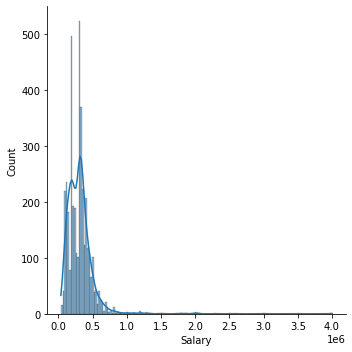

In [30]:
sns.displot(data['Salary'],kde=True)

From the above observation it can be seen that distribution is not normal it has a very curvy graph. Most of the people have salary grater than 0.5 Million. It is some what like Log-normal distribution.

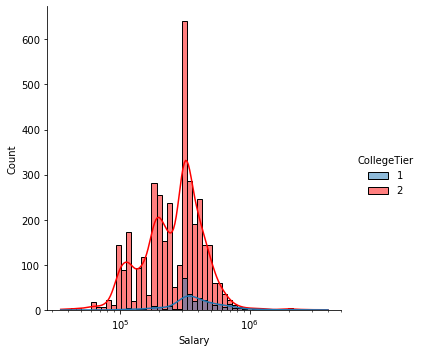

In [31]:
sns.displot(data=data,x='Salary',kde=True,log_scale=True,hue='CollegeTier',palette=['#1f77b4','#FF0000'])

From the above obsertation it can be seen that tier 2 college people have higher number of people who got higher salary than the tier1 college people.

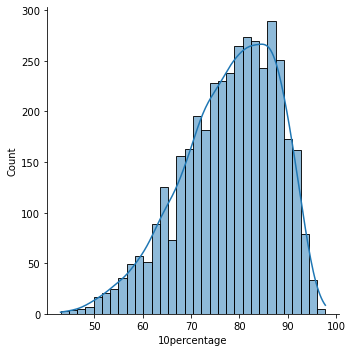

In [32]:
sns.displot(data=data,x='10percentage',kde=True)

It is like left skewed normal distribution. Most of the people have percentage around 90%.

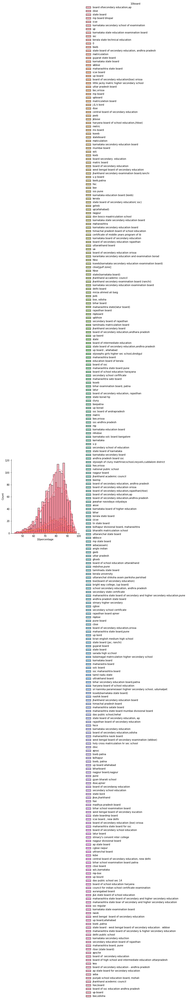

In [33]:
sns.displot(data=data,x='10percentage',kde=True,hue='10board')

It shows the distribution of percentage based on the Board a person had studied. It shows that people from Andhra Pradesh Board have highest people arount all the percentages.

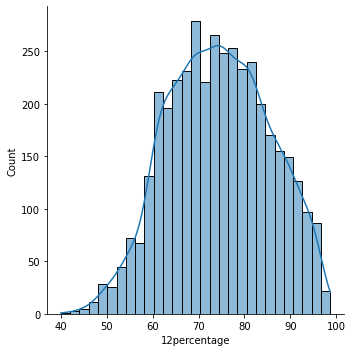

In [34]:
sns.displot(data=data,x='12percentage',kde=True)

It is like left skewed normal distribution. Most of the people have percentage around 69%.

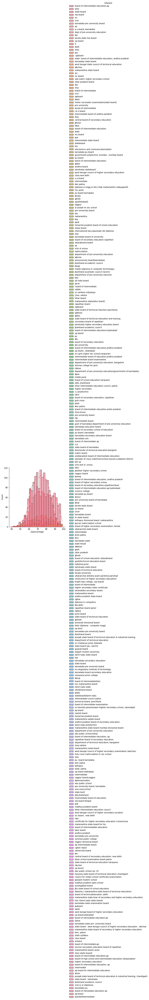

In [35]:
sns.displot(data=data,x='12percentage',kde=True,hue='12board')

It shows the distribution of percentage based on the Board a person had studied. It shows that people from Andhra Pradesh Board have highest people arount all the percentages.

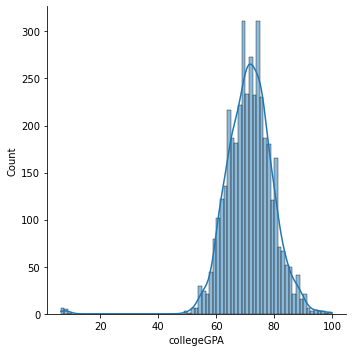

In [36]:
sns.displot(data=data,x='collegeGPA',kde=True)

From the above observation it seem like a left a normal distibution but not. Most of the people are in range of 60-80 percentage.

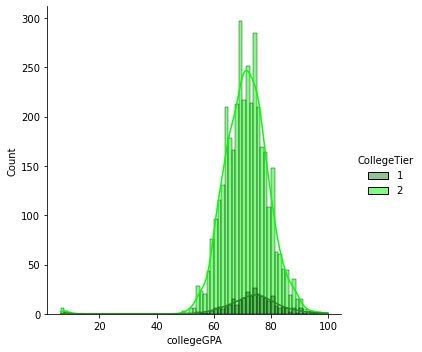

In [37]:
sns.displot(data=data,x='collegeGPA',kde=True,hue='CollegeTier',palette=['#228B22','#00FF00'])

People from college 2 have count of %es more thatn the tier1.

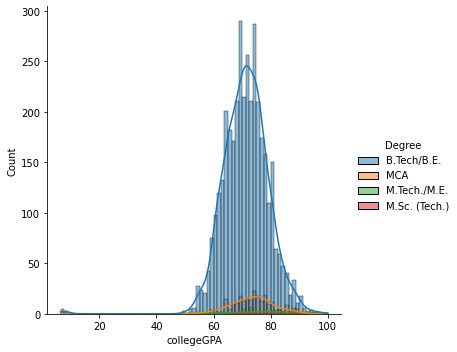

In [38]:
sns.displot(data=data,x='collegeGPA',kde=True,hue='Degree')

Based on the degree B.Tech / B.E people are more in count than other Degrees

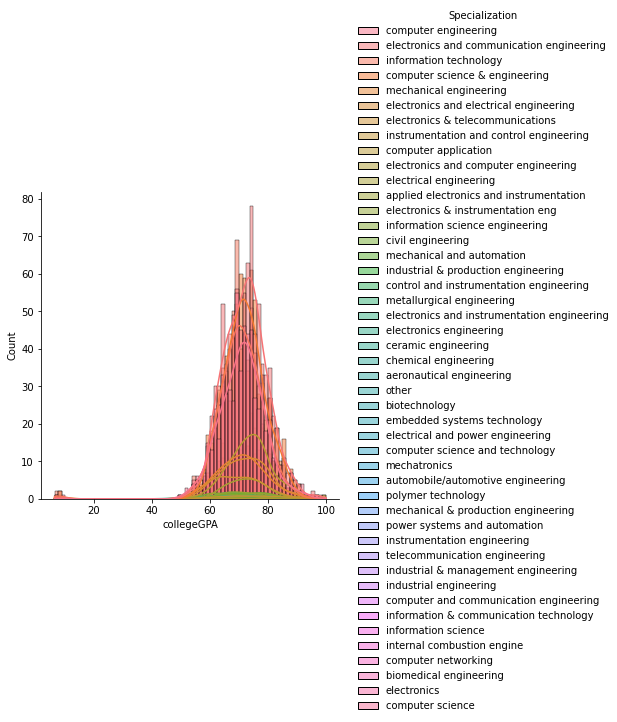

In [39]:
sns.displot(data=data,x='collegeGPA',kde=True,hue='Specialization')

College GPA based on Specilization can be seen above. Computer Engineering people are more frequent in %ge.

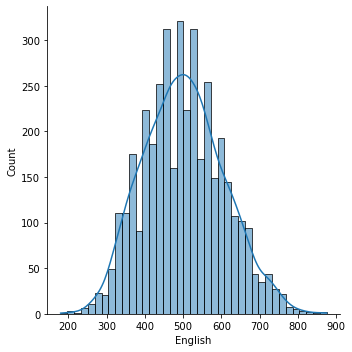

In [40]:
sns.displot(data=data,x='English',kde=True)

It is some what like normal diatribution. Most of people scored around 500-600.

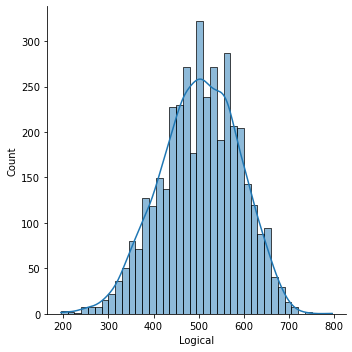

In [41]:
sns.displot(data=data,x='Logical',kde=True)

It is some what like normal diatribution. Most of people scored around 500-600.

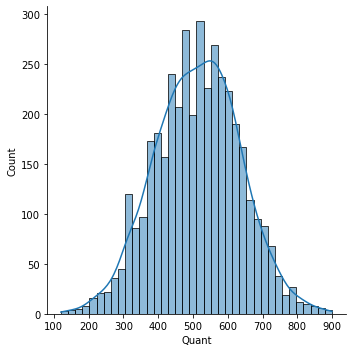

In [42]:
sns.displot(data=data,x='Quant',kde=True)

It is some what like normal diatribution. Most of people scored around 500-600.

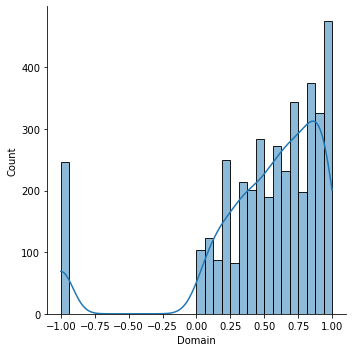

In [43]:
sns.displot(data=data,x='Domain',kde=True)

Most of people scored around 1.

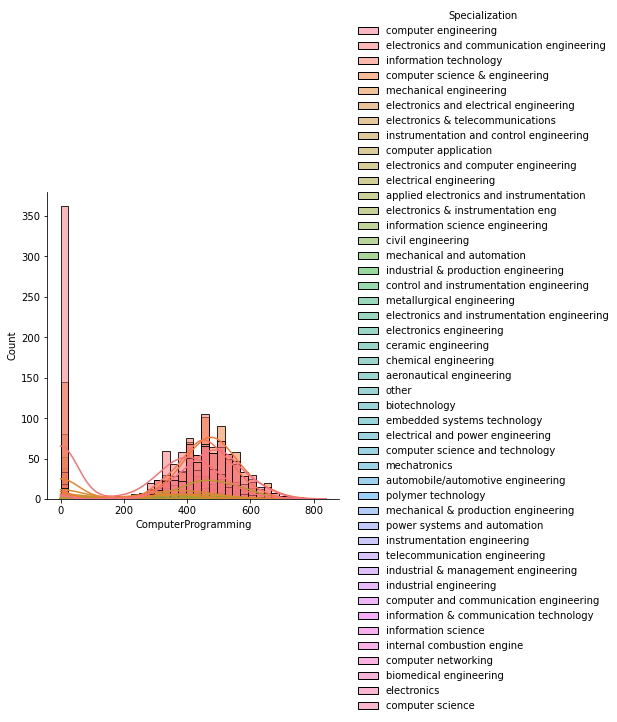

In [44]:
sns.displot(data=data,x='ComputerProgramming',kde=True,hue='Specialization')

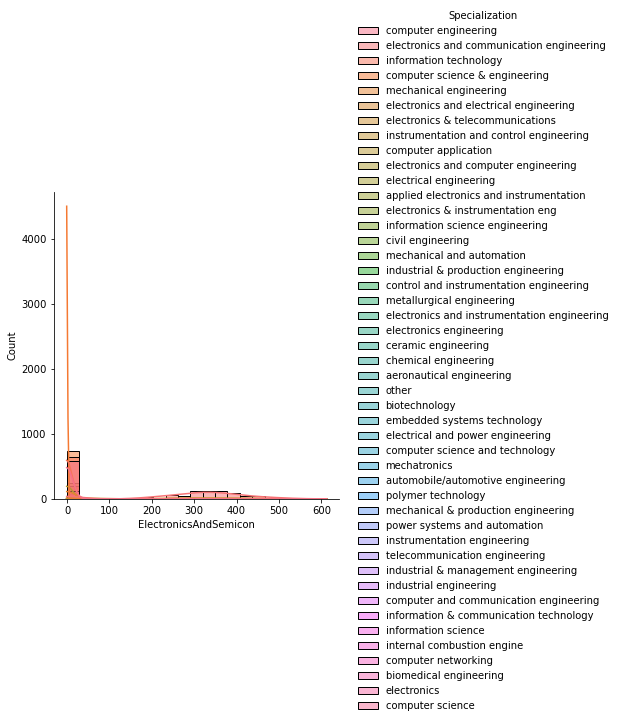

In [45]:
sns.displot(data=data,x='ElectronicsAndSemicon',kde=True,hue='Specialization')

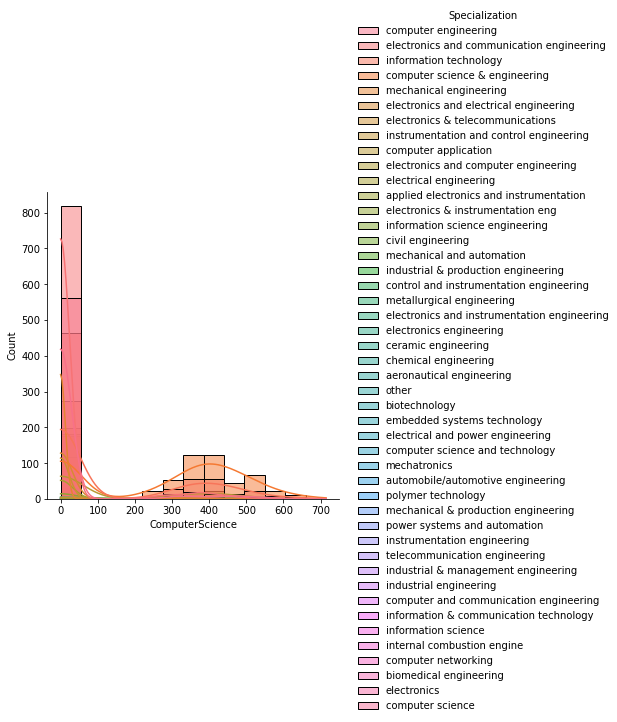

In [46]:
sns.displot(data=data,x='ComputerScience',kde=True,hue='Specialization')

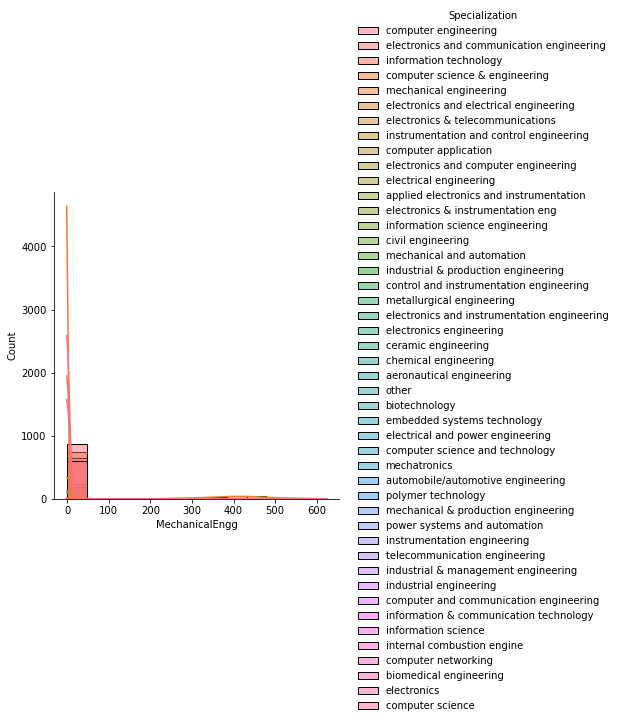

In [47]:
sns.displot(data=data,x='MechanicalEngg',kde=True,hue='Specialization')

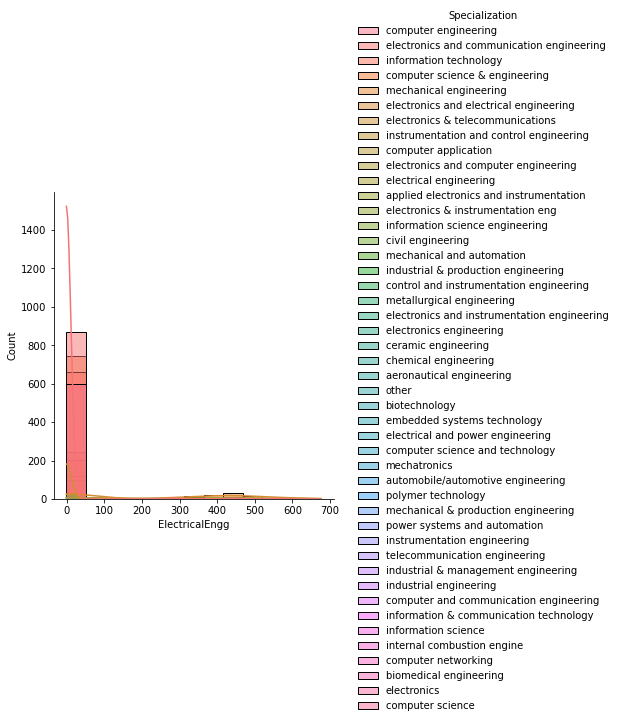

In [48]:
sns.displot(data=data,x='ElectricalEngg',kde=True,hue='Specialization')

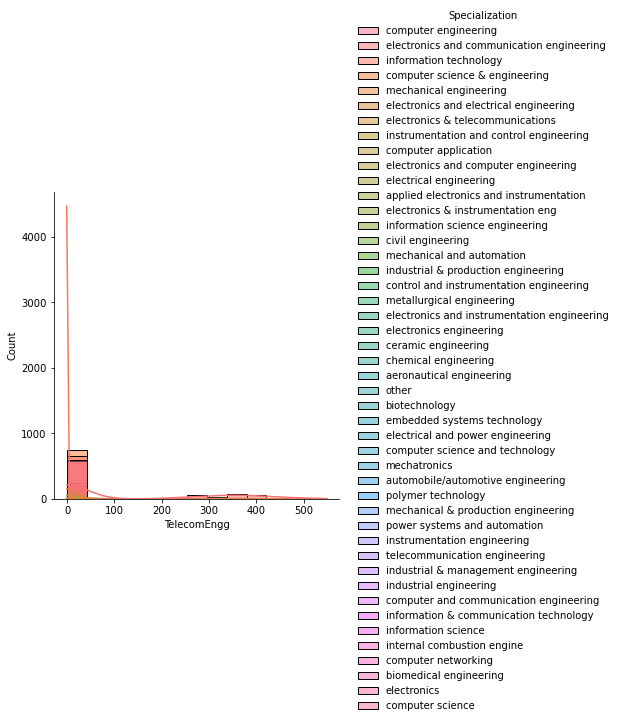

In [49]:
sns.displot(data=data,x='TelecomEngg',kde=True,hue='Specialization')

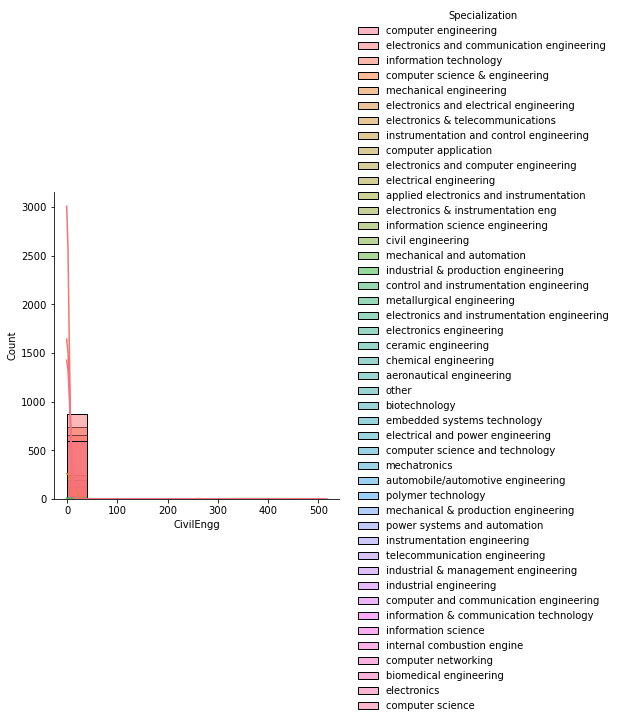

In [50]:
sns.displot(data=data,x='CivilEngg',kde=True,hue='Specialization')

From the above graphs people with a specilization have sored most in thier respective sections of specilizations 

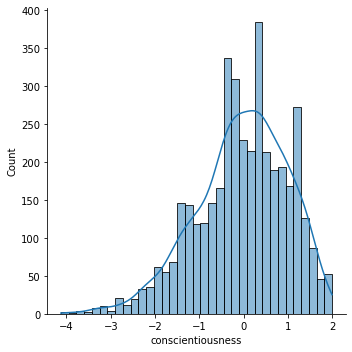

In [51]:
sns.displot(data=data,x='conscientiousness',kde=True)

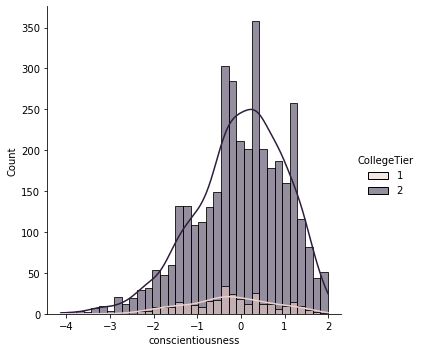

In [52]:
sns.displot(data=data,x='conscientiousness',kde=True,hue='CollegeTier')

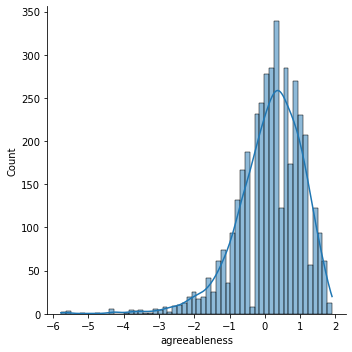

In [53]:
sns.displot(data=data,x='agreeableness',kde=True)

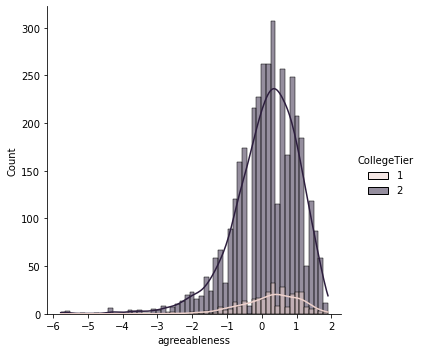

In [54]:
sns.displot(data=data,x='agreeableness',kde=True,hue='CollegeTier')

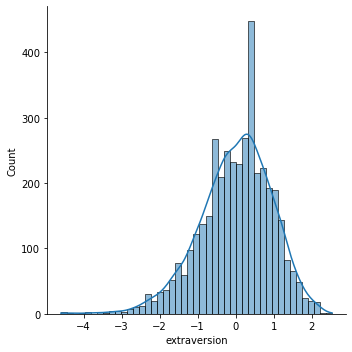

In [55]:
sns.displot(data=data,x='extraversion',kde=True)

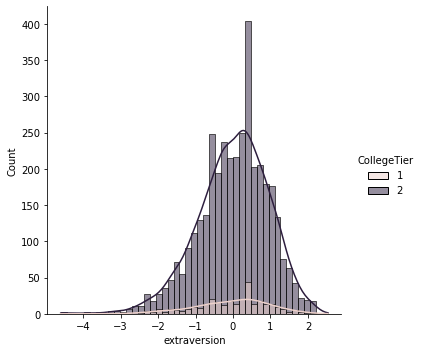

In [56]:
sns.displot(data=data,x='extraversion',kde=True,hue='CollegeTier')

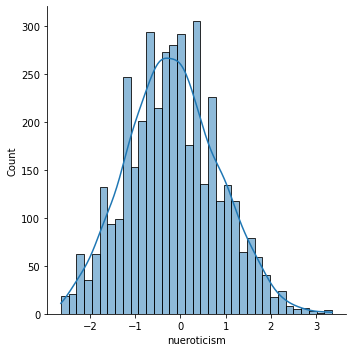

In [57]:
sns.displot(data=data,x='nueroticism',kde=True)

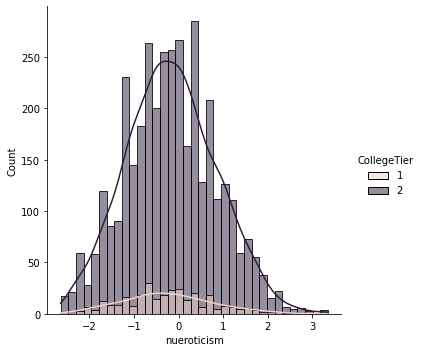

In [58]:
sns.displot(data=data,x='nueroticism',kde=True,hue='CollegeTier')

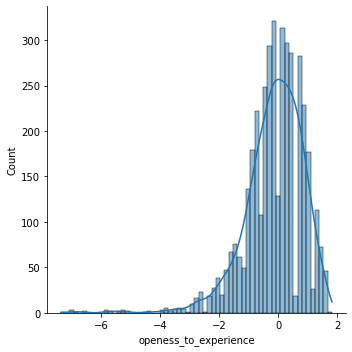

In [59]:
sns.displot(data=data,x='openess_to_experience',kde=True)

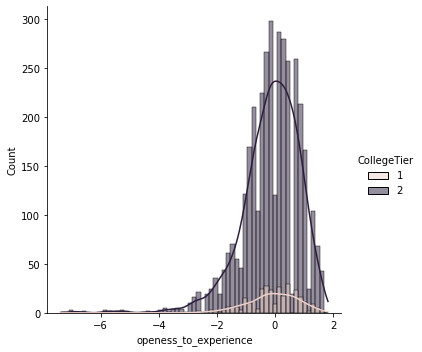

In [60]:
sns.displot(data=data,x='openess_to_experience',kde=True,hue='CollegeTier')

From the above graphs it can be seen that people from tire 2 college are more frequent than tier 1 college.

**Distributions of Categorical Ffeatures**

<AxesSubplot:xlabel='Designation', ylabel='count'>

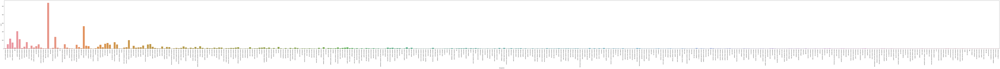

In [61]:
plt.figure(figsize=(200,10))
plt.xticks(rotation=90)
sns.countplot(data=data,x='Designation')

In [62]:
pvt_df = data.pivot_table(values = 'Salary', index = 'Designation')
px.bar(pvt_df, x = pvt_df.index, y = 'Salary')

<AxesSubplot:xlabel='Designation', ylabel='Salary'>

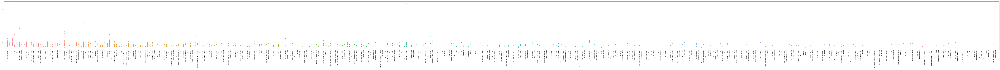

In [63]:
plt.figure(figsize=(200,10))
plt.xticks(rotation=90)
sns.stripplot(data=data,x='Designation',y='Salary')

observations from the above are the most frequent job is software Engineer and the highest paying job is junior manager.

<AxesSubplot:xlabel='JobCity', ylabel='count'>

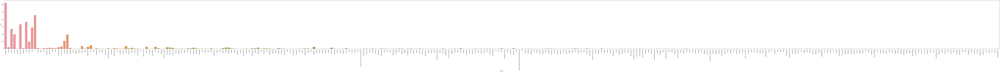

In [64]:
plt.figure(figsize=(200,10))
plt.xticks(rotation=90)
sns.countplot(data=data,x='JobCity')

In [65]:
pvt_df = data.pivot_table(values = 'Salary', index = 'JobCity')
px.bar(pvt_df, x = pvt_df.index, y = 'Salary')

We can obeserve that most of the jobs are in Banglore. And the highest paying job is in Kalmar,Sweden.

<AxesSubplot:xlabel='Gender', ylabel='count'>

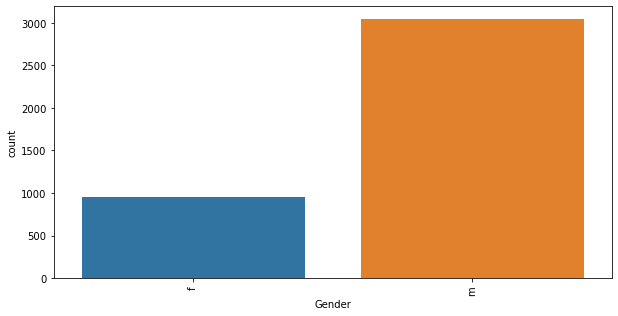

In [66]:
plt.figure(figsize=(10,5))
plt.xticks(rotation=90)
sns.countplot(data=data,x='Gender')

In [67]:
pvt_df = data.pivot_table(values = 'Salary', index = 'Gender')
px.bar(pvt_df, x = pvt_df.index, y = 'Salary')

from the above observations male has highest job counts and have highes paid job also.

<AxesSubplot:xlabel='10board', ylabel='count'>

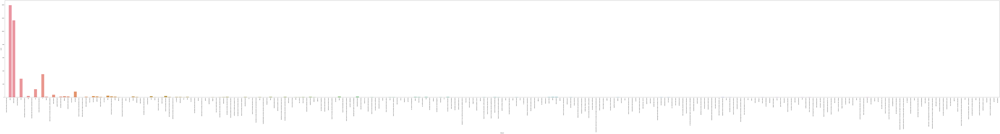

In [68]:
plt.figure(figsize=(200,20))
plt.xticks(rotation=90)
sns.countplot(data=data,x='10board')

In [69]:
pvt_df = data.pivot_table(values = '10percentage', index = '10board')
px.bar(pvt_df, x = pvt_df.index, y = '10percentage')

From above observations people from jawhar navodya vidhyalaya have scored average of 94.4%

In [70]:
pvt_df = data.pivot_table(values = '12percentage', index = '12board')
px.bar(pvt_df, x = pvt_df.index, y = '12percentage')

From above observation A.P Intermediate board has got highest marks 97.2%

In [71]:
pvt_df = data.pivot_table(values = 'Salary', index = 'CollegeTier')
px.bar(pvt_df, x = pvt_df.index, y = 'Salary')

Collge tier 1 has got the highest salary among thr tow tiers

In [72]:
pvt_df = data.pivot_table(values = 'Salary', index = 'Degree')
px.bar(pvt_df, x = pvt_df.index, y = 'Salary')

People from M.Tech./M.E got highest average packages.  

**Let's see the relation between two columns**  

In [73]:
px.scatter(data,x='Salary',y='10percentage')

Salary and 10oecentage are +ve'ly correlated to each other as percentage is increasing salaring is also increasing.

In [74]:
px.scatter(data,x='Salary',y='12percentage')

Salary and 12percentage are +ve'ly correlated to each other as 12percentage is increasing salaring is also increasing.

In [75]:
px.scatter(data,x='Salary',y='collegeGPA')

Salary and collegeGPA are +ve'ly correlated to each other as CollegeGPA is increasing salaring is also increasing.

In [76]:
px.scatter(data,x='10percentage',y='English')

It says that both are +ve'ly correlated

In [77]:
px.scatter(data,x='12percentage',y='English')

It can be seen that both are +ve'ly correlated

In [78]:
px.scatter(data,x='collegeGPA',y='English')

It can be seen that both are +ve'ly correlated

In [79]:
px.scatter(data,x='10percentage',y='Logical')

In [80]:
px.scatter(data,x='collegeGPA',y='Quant')

In [81]:
px.scatter(data,x='collegeGPA',y='Domain')

It has a uniform relationship. +ve'ly cprrelated.

In [82]:
px.scatter(data,x='10percentage',y='Logical')

They are positively correlated

In [83]:
px.scatter(data,x='10percentage',y='Quant')

They are Positively correlated

In [84]:
px.scatter(data,x='10percentage',y='Domain')

In [85]:
px.scatter(data,x='12percentage',y='Logical')

In [86]:
px.scatter(data,x='12percentage',y='Quant')

In [87]:
px.scatter(data,x='12percentage',y='Domain')

In [88]:
px.scatter(data,x='collegeGPA',y='ComputerProgramming')

In [89]:
px.scatter(data,x='collegeGPA',y='ElectronicsAndSemicon')

In [90]:
px.scatter(data,x='collegeGPA',y='ComputerScience')

In [91]:
px.scatter(data,x='collegeGPA',y='MechanicalEngg')

In [92]:
px.scatter(data,x='collegeGPA',y='ElectricalEngg')

In [93]:
px.scatter(data,x='collegeGPA',y='TelecomEngg')

In [94]:
px.scatter(data,x='collegeGPA',y='CivilEngg')

**From the above observations most of them are positively correlated to each other**

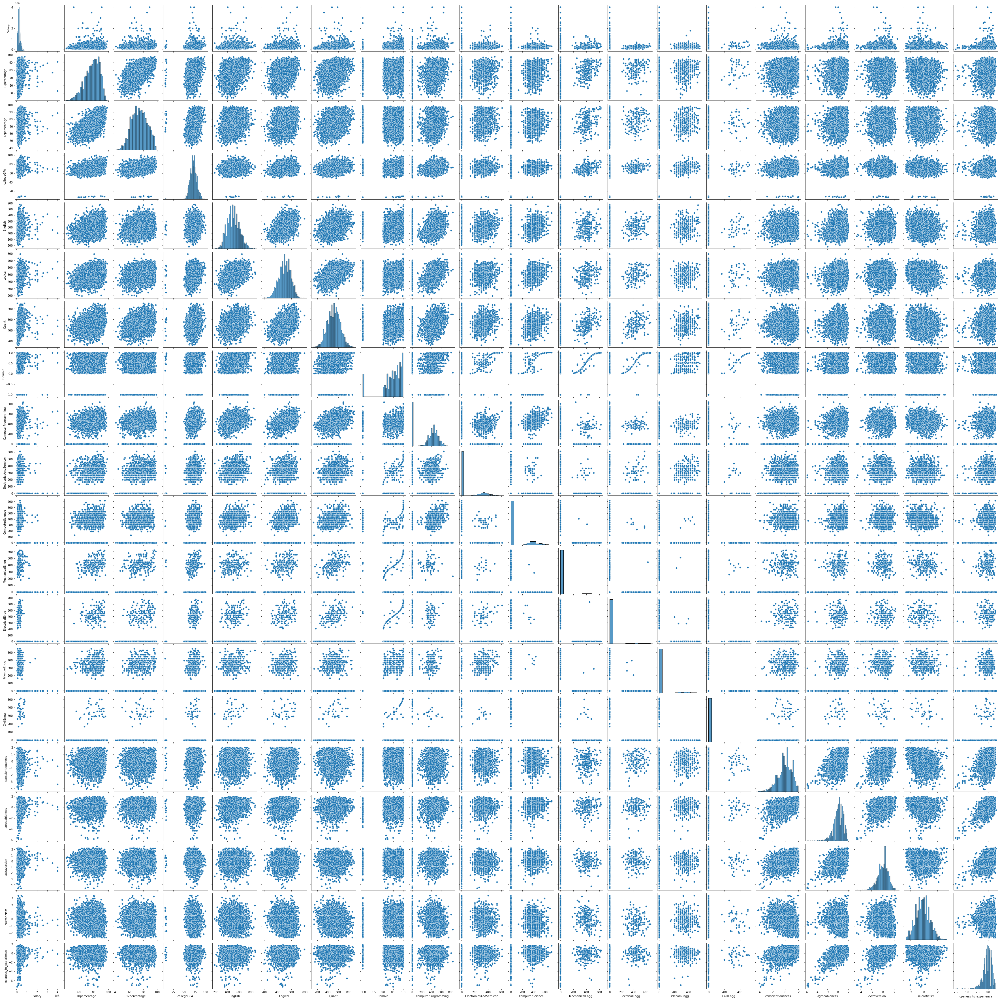

In [95]:
sns.pairplot(data[contin_cols])

<AxesSubplot:>

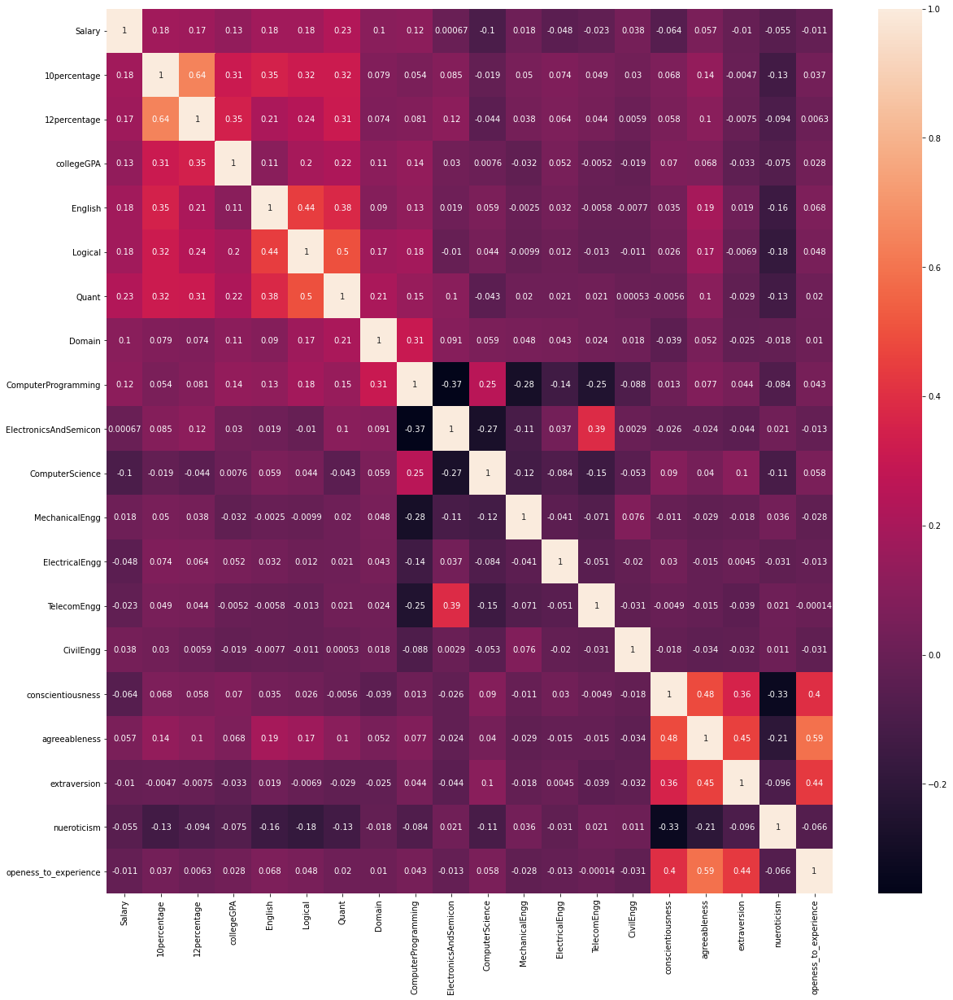

In [96]:
plt.figure(figsize=(20,20))
plt.xticks(rotation=90)
sns.heatmap(data[contin_cols].corr(),annot=True)

**Relations between continous and categorical column**

In [97]:
px.strip(x=data['Designation'],y=data['Salary'])

<AxesSubplot:xlabel='Designation', ylabel='Salary'>

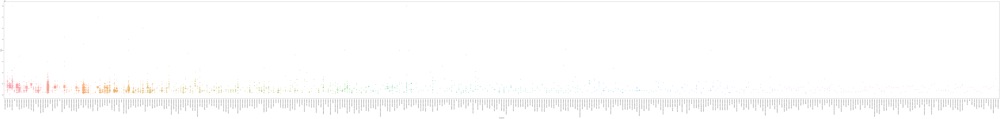

In [98]:
plt.figure(figsize=(200,20))
plt.xticks(rotation=90)
sns.swarmplot(x=data['Designation'],y=data['Salary'])

In [99]:
px.strip(x=data['Gender'],y=data['Salary'])

In [100]:
px.strip(x=data['Degree'],y=data['Salary'])

<AxesSubplot:xlabel='Specialization', ylabel='Salary'>

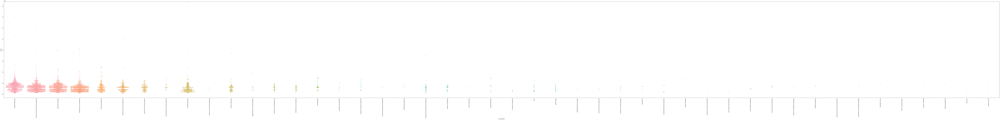

In [101]:
plt.figure(figsize=(200,20))
plt.xticks(rotation=90)
sns.swarmplot(x=data['Specialization'],y=data['Salary'])

In [102]:
px.strip(x=data['Degree'],y=data['Salary'])

<AxesSubplot:xlabel='Specialization', ylabel='ComputerProgramming'>

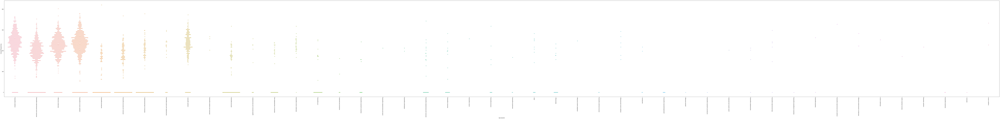

In [103]:
plt.figure(figsize=(200,20))
plt.xticks(rotation=90)
sns.swarmplot(x=data['Specialization'],y=data['ComputerProgramming'])

<AxesSubplot:xlabel='Specialization', ylabel='ElectronicsAndSemicon'>

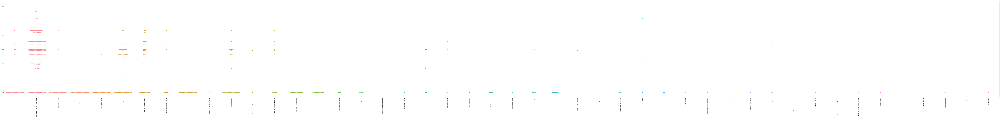

In [104]:
plt.figure(figsize=(200,20))
plt.xticks(rotation=90)
sns.swarmplot(x=data['Specialization'],y=data['ElectronicsAndSemicon'])

<AxesSubplot:xlabel='Specialization', ylabel='ComputerScience'>

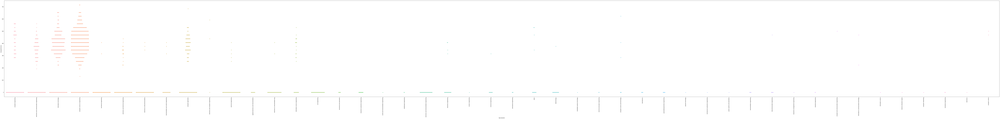

In [105]:
plt.figure(figsize=(200,20))
plt.xticks(rotation=90)
sns.swarmplot(x=data['Specialization'],y=data['ComputerScience'])

<AxesSubplot:xlabel='Specialization', ylabel='MechanicalEngg'>

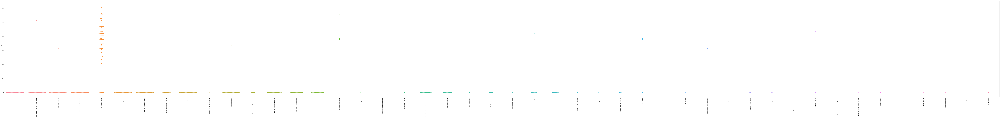

In [106]:
plt.figure(figsize=(200,20))
plt.xticks(rotation=90)
sns.swarmplot(x=data['Specialization'],y=data['MechanicalEngg'])

<AxesSubplot:xlabel='Specialization', ylabel='ElectricalEngg'>

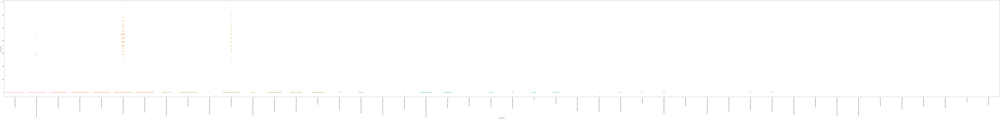

In [107]:
plt.figure(figsize=(200,20))
plt.xticks(rotation=90)
sns.swarmplot(x=data['Specialization'],y=data['ElectricalEngg'])

<AxesSubplot:xlabel='Specialization', ylabel='TelecomEngg'>

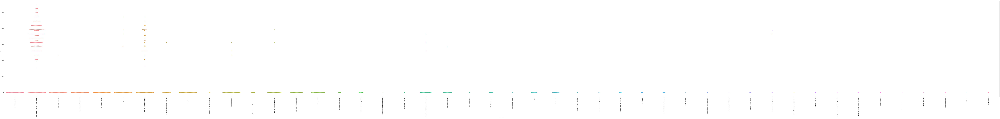

In [108]:
plt.figure(figsize=(200,20))
plt.xticks(rotation=90)
sns.swarmplot(x=data['Specialization'],y=data['TelecomEngg'])

<AxesSubplot:xlabel='Specialization', ylabel='CivilEngg'>

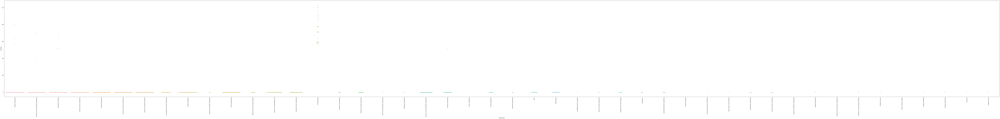

In [109]:
plt.figure(figsize=(200,20))
plt.xticks(rotation=90)
sns.swarmplot(x=data['Specialization'],y=data['CivilEngg'])

From the above observation we can see that salary is related with Designation,Gender,Specilization,Degree. And the test scores are also depemdent on specilization,Degree.

Research Questions
- Times of India article dated Jan 18, 2019 states that “After doing your Computer Science Engineering if you take up jobs as a Programming Analyst, Software Engineer, Hardware Engineer and Associate Engineer you can earn up to 2.5-3 lakhs as a fresh graduate.” Test this claim with the data given to you.


- Is there a relationship between gender and specialisation? (i.e. Does the preference of Specialisation depend on the Gender?)  

<b>Times of India article dated Jan 18, 2019 states that “After doing your Computer Science Engineering if you take up jobs as a Programming Analyst, Software Engineer, Hardware Engineer and Associate Engineer you can earn up to 2.5-3 lakhs as a fresh graduate.” Test this claim with the data given to you.<b>  
    
Step - 1:  
Alternate Hypothesis (Bold claim): $$ H_1: \ Average\ Salary\ of\ Programming\ Analyst,\ Software\ Engineer,\ Hardware\ Engineer\ and\ Associate\ Engineer\ \gt 300000 $$
Null Hypothesis (Status Quo): $$ H_0: \ Average\ Salary\ of\ Programming\ Analyst,\ Software\ Engineer,\ Hardware\ Engineer\ and\ Associate\ Engineer\ \le 300000 $$

Step - 2:  
* Collect a sample of size n = 154
* Compute sample mean $$ \bar{x} \ = \ 334772.7273 $$

Step - 3:
Compute Test Statistic: $$ t = \frac{\bar{x} - \mu}{S/\sqrt[2]{n}}$$

Step - 4:
Decide $ \alpha $

Step - 5.1: right tailed t-test: $$ reject \ H_0 \ if\ t\ score \gt 1.7291328$$

Step - 5.2: Compute p-value
$$ if (p \ value < 0.05) \Rightarrow Accept \ H_1 \ or \ Reject \ H_0 $$

In [110]:
confidence_level = 0.95
alpha = 1 - confidence_level
t_critical =t.ppf(1 - alpha,19)
print(t_critical)

1.729132811521367


In [111]:
jobs=['programmer analyst', 'software engineere', 'hardware engineer', 'associate engineer']

In [112]:
data['Specialization'].unique()

array(['computer engineering',
       'electronics and communication engineering',
       'information technology', 'computer science & engineering',
       'mechanical engineering', 'electronics and electrical engineering',
       'electronics & telecommunications',
       'instrumentation and control engineering', 'computer application',
       'electronics and computer engineering', 'electrical engineering',
       'applied electronics and instrumentation',
       'electronics & instrumentation eng',
       'information science engineering', 'civil engineering',
       'mechanical and automation', 'industrial & production engineering',
       'control and instrumentation engineering',
       'metallurgical engineering',
       'electronics and instrumentation engineering',
       'electronics engineering', 'ceramic engineering',
       'chemical engineering', 'aeronautical engineering', 'other',
       'biotechnology', 'embedded systems technology',
       'electrical and power engi

In [113]:
salarys=list(data[((data['Designation']=='programmer analyst')|(data['Designation']=='software engineere')|
             (data['Designation']=='hardware engineer')|(data['Designation']=='associate engineer'))&
                  (data['Specialization']=='computer science & engineering')]['Salary'])

In [114]:
def to_lakhs(rupees):
    return rupees/100000
salarys=list(map(to_lakhs,salarys))

In [115]:
# mean of samples
sum(salarys)/len(salarys)

3.244642857142857

In [116]:
sample_mean=3.244642857142857
population_mean=3
sample_std=np.std(np.array(salarys))
sample_size=len(salarys)

In [117]:
print(max(salarys))
min(salarys)

4.0


1.8

Text(3.244642857142857, 0.1, 'x_bar')

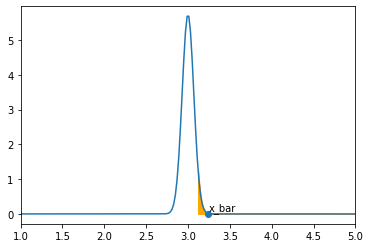

In [118]:
x_min = 1
x_max = 5

mean = population_mean
std = sample_std / (sample_size**0.5)

x = np.linspace(x_min, x_max, 200)
y = norm.pdf(x, mean, std)
plt.xlim(x_min, x_max)

plt.plot(x, y)

t_critical_right = population_mean + (t_critical * std)

x1 = np.linspace(t_critical_right, x_max, 100)
y1 = norm.pdf(x1, mean, std)
plt.fill_between(x1, y1, color='orange')

plt.scatter(sample_mean, 0)
plt.annotate("x_bar", (sample_mean, 0.1))

In [119]:
def t_score(sample_size, sample_mean, pop_mean, sample_std):
    numerator = sample_mean - pop_mean
    denomenator = sample_std/ sample_size**0.5
    return numerator / denomenator

In [120]:
t_stat=t_score(sample_size,sample_mean,population_mean,sample_std)
print("t score =",t_stat,sep=" ")

t score = 3.5248004293322683


In [121]:
if(abs(t_stat) > t_critical):
    print("Reject Null Hypothesis")
else:
    print("Fail to reject Null Hypothesis")

Reject Null Hypothesis


In [122]:
p_value = 1.0 - norm.cdf(np.abs(t_stat))

print("p_value = ", p_value)

if(p_value < 0.05):
    print("Reject Null Hypothesis")
else:
    print("Fail to reject Null Hypothesis")

p_value =  0.0002119009723782206
Reject Null Hypothesis


**Is there a relationship between gender and specialisation? (i.e. Does the preference of Specialisation depend on the Gender?)**  

Step - 1:  
Alternate Hypothesis (Bold Claim): $$ H_1: \ Gender\ and\ Specialisation\ are\ correlated $$
Null Hypothesis (Status Quo): $$ H_0: \ Gender\ and\ Specialisation\ are\ not\ correlated $$

Step - 2:
Compute observed and expected values

Step - 3:
Compute Test Statistic: $$ \chi^2 = \sum\left(\frac{O_i-E_i}{E_i}\right)$$

Step - 4:
Decide $ \alpha $

Step - 5: Compute p-value
$$ if (p \ value < 0.05) \Rightarrow Accept \ H_1 \ or \ Reject \ H_0 $$

In [123]:
cont=pd.crosstab(data['Specialization'],data['Gender'])
chi2_contingency(cont)

(104.46891913608454,
 1.2453868176977011e-06,
 45,
 array([[7.18109055e-01, 2.28189095e+00],
        [2.15432716e+00, 6.84567284e+00],
        [1.19684842e+00, 3.80315158e+00],
        [4.78739370e-01, 1.52126063e+00],
        [3.59054527e+00, 1.14094547e+01],
        [2.39369685e-01, 7.60630315e-01],
        [2.15432716e+00, 6.84567284e+00],
        [6.94172086e+00, 2.20582791e+01],
        [2.39369685e-01, 7.60630315e-01],
        [5.84062031e+01, 1.85593797e+02],
        [1.43621811e+02, 4.56378189e+02],
        [2.39369685e-01, 7.60630315e-01],
        [4.78739370e-01, 1.52126063e+00],
        [1.78091046e+02, 5.65908954e+02],
        [1.43621811e+00, 4.56378189e+00],
        [2.39369685e-01, 7.60630315e-01],
        [4.78739370e-01, 1.52126063e+00],
        [1.96283142e+01, 6.23716858e+01],
        [2.39369685e-01, 7.60630315e-01],
        [7.65982991e+00, 2.43401701e+01],
        [2.89637319e+01, 9.20362681e+01],
        [2.10645323e+02, 6.69354677e+02],
        [7.18109055e-01, 

In [124]:
if chi2_contingency(cont)[1]<0.05:
    print("Reject Null Hypothesis")
else:
    print("Fail to reject Null Hypothesis")

Reject Null Hypothesis


**Observation**  
Gender and Specilization are correlated  

**lets do this for all Categorical Features**  

**Reaserch Question** are all categorical columns are related to each other ot not?(Check the relation between each other)

In [125]:
for col1 in categor_cols:
    for col2 in categor_cols:
        if col1!=col2:
            cont=pd.crosstab(data['Specialization'],data['Gender'])
            if chi2_contingency(cont)[1]<0.05:
                print(col1,"and",col2,"are correlated",sep=" ")
            else:
                 print(col1,"and",col2,"are not correlated",sep=" ")

Designation and JobCity are correlated
Designation and Gender are correlated
Designation and 10board are correlated
Designation and 12board are correlated
Designation and CollegeID are correlated
Designation and CollegeTier are correlated
Designation and Degree are correlated
Designation and Specialization are correlated
Designation and CollegeCityID are correlated
Designation and CollegeCityTier are correlated
Designation and CollegeState are correlated
JobCity and Designation are correlated
JobCity and Gender are correlated
JobCity and 10board are correlated
JobCity and 12board are correlated
JobCity and CollegeID are correlated
JobCity and CollegeTier are correlated
JobCity and Degree are correlated
JobCity and Specialization are correlated
JobCity and CollegeCityID are correlated
JobCity and CollegeCityTier are correlated
JobCity and CollegeState are correlated
Gender and Designation are correlated
Gender and JobCity are correlated
Gender and 10board are correlated
Gender and 12boa

**From thr above observations Categorical features are related to eachother.**

**Conclusions**  
From the above Exploratory Data Analysis on the given data we can conclude that 
- the Continuous features are not normaly distributed and not standardised.
- No missing values are present
- Most of the job holders are Software Engineers 
- Most of the people work in Banglure
- Most of the people are from B.Tech
- Most of the numerical Features are +ve'ly Correlated and some are -ve'ly correlated.
- All categorical features are correlated to each other.
- People From conputer science engineering are having high paid salary  

**Frsture trsnsformation on Continuous and Categorical Features**

In [126]:
from sklearn.preprocessing import StandardScaler
standard=StandardScaler()
data1=data
for col in ['Salary','10percentage','12percentage','collegeGPA','English','Logical','Quant','Domain' ,'conscientiousness',
            'agreeableness','extraversion','nueroticism','openess_to_experience']:
    data1[col]=standard.fit_transform(np.array(data1[col]).reshape(-1,1))

In [127]:
for col in ['ComputerProgramming','ElectronicsAndSemicon','ComputerScience','MechanicalEngg','ElectricalEngg','TelecomEngg',
            'CivilEngg']:
    data1[col].replace(-1,0,inplace=True)
for col in ['ComputerProgramming','ElectronicsAndSemicon','ComputerScience','MechanicalEngg','ElectricalEngg','TelecomEngg',
            'CivilEngg']:
    data1[col]=standard.fit_transform(np.array(data1[col]).reshape(-1,1))

In [128]:
data1[contin_cols]

,Salary,10percentage,12percentage,collegeGPA,English,Logical,Quant,Domain,ComputerProgramming,ElectronicsAndSemicon,ComputerScience,MechanicalEngg,ElectricalEngg,TelecomEngg,CivilEngg,conscientiousness,agreeableness,extraversion,nueroticism,openess_to_experience
ID,,,,,,,,,,,,,,,,,,,,
203097,0.527947,0.647233,1.939676,0.797646,0.127240,0.961148,0.095037,0.267789,0.447317,-0.608684,-0.523414,-0.244337,-0.199563,-0.313303,-0.100489,0.983466,0.707581,0.550939,1.512658,-0.304966
579905,0.904045,0.758921,0.957729,-0.174641,1.842720,1.249258,2.180295,0.960524,-1.723886,2.344667,-0.523414,-0.244337,-0.199563,-0.313303,-0.100489,-0.676367,0.246801,1.300083,0.060978,0.993910
810601,0.081332,0.718307,-0.569744,-0.181988,1.080285,0.500173,-1.172473,-0.127212,0.203362,-0.608684,-0.523414,-0.244337,-0.199563,-0.313303,-0.100489,0.301041,1.661318,0.169167,-0.693995,0.803821
267447,3.724775,0.779227,0.830439,0.386200,1.270894,0.961148,0.912785,0.989957,1.276765,-0.608684,-0.523414,-0.244337,-0.199563,-0.313303,-0.100489,0.081894,0.210589,-0.364495,-0.237001,-0.775129
343523,-0.506320,0.007570,0.212176,0.295584,0.413154,1.422124,-0.395612,-0.823681,-1.723886,0.867992,-0.523414,-0.244337,-0.199563,-0.313303,-0.100489,-0.819775,-0.452174,-1.127304,0.258734,0.008542
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
47916,-0.130223,-2.623172,-1.724441,-1.222849,-1.302326,-1.931475,-0.313837,-0.500290,-0.040594,-0.608684,-0.523414,-0.244337,-0.199563,-0.313303,-0.100489,-0.068416,0.210589,0.245794,0.812774,-0.775129
752781,-0.976442,1.225977,1.685097,0.711928,-0.825804,-1.055621,0.176812,0.791977,-0.138176,2.053135,-0.523414,-0.244337,-0.199563,-0.313303,-0.100489,-0.257520,0.777245,0.976964,0.941813,0.043465
355888,0.057826,0.399491,-0.815231,-0.181988,-0.253978,-0.306535,-0.395612,-0.047249,0.252153,-0.608684,-0.523414,-0.244337,-0.199563,-0.313303,-0.100489,-1.495978,-1.777487,-1.584968,-1.140864,-0.618474


In [129]:
from sklearn.preprocessing import MinMaxScaler
minMax=MinMaxScaler()
for col in ['Salary','10percentage','12percentage','collegeGPA','English','Logical','Quant','Domain' ,'conscientiousness',
            'agreeableness','extraversion','nueroticism','openess_to_experience']:
    data[col]=minMax.fit_transform(np.array(data[col]).reshape(-1,1))
for col in ['ComputerProgramming','ElectronicsAndSemicon','ComputerScience','MechanicalEngg','ElectricalEngg','TelecomEngg',
            'CivilEngg']:
    data[col].replace(-1,0,inplace=True)
for col in ['ComputerProgramming','ElectronicsAndSemicon','ComputerScience','MechanicalEngg','ElectricalEngg','TelecomEngg',
            'CivilEngg']:
    data[col]=minMax.fit_transform(np.array(data[col]).reshape(-1,1))

In [130]:
data[contin_cols]

,Salary,10percentage,12percentage,collegeGPA,English,Logical,Quant,Domain,ComputerProgramming,ElectronicsAndSemicon,ComputerScience,MechanicalEngg,ElectricalEngg,TelecomEngg,CivilEngg,conscientiousness,agreeableness,extraversion,nueroticism,openess_to_experience
ID,,,,,,,,,,,,,,,,,,,,
203097,0.097100,0.754200,0.950596,0.765404,0.482014,0.650000,0.519231,0.818026,0.529762,0.000000,0.000000,0.0,0.0,0.0,0.0,0.833126,0.857931,0.718552,0.666817,0.753438
579905,0.117276,0.774288,0.766610,0.680466,0.741007,0.691667,0.846154,0.980346,0.000000,0.761438,0.000000,0.0,0.0,0.0,0.0,0.554263,0.801481,0.818421,0.422884,0.895772
810601,0.073140,0.766983,0.480409,0.679825,0.625899,0.583333,0.320513,0.725471,0.470238,0.000000,0.000000,0.0,0.0,0.0,0.0,0.718474,0.974774,0.667657,0.296022,0.874942
267447,0.268600,0.777940,0.742760,0.729461,0.654676,0.650000,0.647436,0.987242,0.732143,0.000000,0.000000,0.0,0.0,0.0,0.0,0.681656,0.797044,0.596514,0.372813,0.701917
343523,0.041614,0.639153,0.626917,0.721545,0.525180,0.716667,0.442308,0.562276,0.000000,0.380719,0.000000,0.0,0.0,0.0,0.0,0.530170,0.715849,0.494822,0.456114,0.787793
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
47916,0.061791,0.165997,0.264055,0.588896,0.266187,0.231667,0.455128,0.638052,0.410714,0.000000,0.000000,0.0,0.0,0.0,0.0,0.656403,0.797044,0.677872,0.549212,0.701917
752781,0.016393,0.858291,0.902896,0.757916,0.338129,0.358333,0.532051,0.940852,0.386905,0.686275,0.000000,0.0,0.0,0.0,0.0,0.624632,0.866465,0.775346,0.570895,0.791620
355888,0.071879,0.709642,0.434412,0.679825,0.424460,0.466667,0.442308,0.744207,0.482143,0.000000,0.000000,0.0,0.0,0.0,0.0,0.416563,0.553484,0.433810,0.220932,0.719083


**Observations**  
All the numerical Features are Standardised. MinMax Scalling is preffered for standardizing.  

**Feature transformation on categorical columns**

In [131]:
def convert_binary(col):
    categ1,categ2=col.unique()
    col=col.replace(categ1,'0')
    col=col.replace(categ2,'1')
    return col

In [132]:
for col in categor_cols:
    if len(data[col].value_counts())==2:
        data[col]=convert_binary(data[col])

In [133]:
for col in categor_cols:
    if len(data[col].value_counts())!=2:
        dummies=pd.get_dummies(data[col])
        data=pd.concat([data,dummies],axis=1)

In [134]:
for col in categor_cols:
    if len(data[col].value_counts())!=2:
        data.drop(col,inplace=True,axis=1)

In [135]:
data

,Salary,DOJ,DOL,Gender,DOB,10percentage,12graduation,12percentage,CollegeTier,collegeGPA,...,Orissa,Punjab,Rajasthan,Sikkim,Tamil Nadu,Telangana,Union Territory,Uttar Pradesh,Uttarakhand,West Bengal
ID,,,,,,,,,,,,,,,,,,,,,
203097,0.097100,2012-06-01,2016-12-31,0,1990-02-19,0.754200,2007-01-01,0.950596,0,0.765404,...,0,0,0,0,0,0,0,0,0,0
579905,0.117276,2013-09-01,2016-12-31,1,1989-10-04,0.774288,2007-01-01,0.766610,0,0.680466,...,0,0,0,0,0,0,0,0,0,0
810601,0.073140,2014-06-01,2016-12-31,0,1992-08-03,0.766983,2010-01-01,0.480409,0,0.679825,...,0,0,0,0,0,0,0,1,0,0
267447,0.268600,2011-07-01,2016-12-31,1,1989-12-05,0.777940,2007-01-01,0.742760,1,0.729461,...,0,0,0,0,0,0,0,0,0,0
343523,0.041614,2014-03-01,2015-03-01,1,1991-02-27,0.639153,2008-01-01,0.626917,0,0.721545,...,0,0,0,0,0,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
47916,0.061791,2011-10-01,2012-10-01,1,1987-04-15,0.165997,2006-01-01,0.264055,0,0.588896,...,0,0,0,0,0,0,0,0,0,0
752781,0.016393,2013-07-01,2013-07-01,0,1992-08-27,0.858291,2009-01-01,0.902896,0,0.757916,...,0,0,0,0,0,1,0,0,0,0
355888,0.071879,2013-07-01,2016-12-31,1,1991-07-03,0.709642,2008-01-01,0.434412,0,0.679825,...,1,0,0,0,0,0,0,0,0,0


**Observations**  
The Categorical features are coverted into categories using dummies.